# Data gathering
To build object detection algorithm images of an object have to be gathered.
In this project we aim at building shark detector.
To scrap images from web we use custom build algorithm which is based on a python library - selenium.
The full code is provided in the code cell below.
It should be run before as a separate script.

In [1]:
"""
# Import libraries
import os
import time
from selenium import webdriver
import urllib.request
import requests
# Selenium code to scroll to bottom of the page
search_query = "shark"
link = "https://www.google.com/search?q={}&tbm=isch&tbs=isz:m".format(search_query)
DRIVER_PATH = '/usr/bin/chromedriver'
driver = webdriver.Chrome(executable_path=DRIVER_PATH)
driver.get(link)
SCROLL_PAUSE_TIME = 2
# Scroll to the bottom of page
last_height = driver.execute_script("return document.body.scrollHeight")
while True:
    driver.execute_script("window.scrollTo(0, document.body.scrollHeight);")
    time.sleep(SCROLL_PAUSE_TIME)
    new_height = driver.execute_script("return document.body.scrollHeight")
    if new_height == last_height:
        try:
            element = driver.find_elements_by_class_name('mye4qd')
            element[0].click()
        except:
            break
    last_height = new_height
# Return a list clickable objects for each individual image
image_links = driver.find_elements_by_class_name('rg_i')
total = len(image_links)
# Download images
count = 0
for el in image_links:
    el.click()
    time.sleep(1)
    main = driver.find_elements_by_class_name('v4dQwb')
    dl_switch = False
    for mn in main:
        src = mn.find_element_by_class_name('n3VNCb').get_attribute("src")
        if src[:4] == 'http' and "encrypted-tbn0" not in src:
            dl_switch = True
            print("{}. {}".format(count, src))
            break
    if dl_switch:
        reponse = requests.get(src)
        if reponse.status_code == 200:
            with open(f"image_{count+1}.jpg","wb") as file:
                file.write(reponse.content)
    count += 1
# Close driver session
driver.quit()
"""

'\n# Import libraries\nimport os\nimport time\nfrom selenium import webdriver\nimport urllib.request\nimport requests\n# Selenium code to scroll to bottom of the page\nsearch_query = "shark"\nlink = "https://www.google.com/search?q={}&tbm=isch&tbs=isz:m".format(search_query)\nDRIVER_PATH = \'/usr/bin/chromedriver\'\ndriver = webdriver.Chrome(executable_path=DRIVER_PATH)\ndriver.get(link)\nSCROLL_PAUSE_TIME = 2\n# Scroll to the bottom of page\nlast_height = driver.execute_script("return document.body.scrollHeight")\nwhile True:\n    driver.execute_script("window.scrollTo(0, document.body.scrollHeight);")\n    time.sleep(SCROLL_PAUSE_TIME)\n    new_height = driver.execute_script("return document.body.scrollHeight")\n    if new_height == last_height:\n        try:\n            element = driver.find_elements_by_class_name(\'mye4qd\')\n            element[0].click()\n        except:\n            break\n    last_height = new_height\n# Return a list clickable objects for each individual image

# Data labeling
Gathered data has to be correctly labeled.
For that various programs are available.
We will be using LabelImg.
It can povide output in a form of PASCAL VOC format.
After the data labeling the final step of data preparation is conversion of labeled images into tensorflow .records format.
This can be done with the [create_pascal_tf_record.py](https://github.com/tensorflow/models/blob/master/research/object_detection/create_pascal_tf_record.py) script.
# Software installation
To train our model we have to download and in necessary libraries.
We follow here steps from [THIS](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/install.html) tutorial.  
First we clone models repository.


In [2]:
# Clone the tensorflow models repository
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 2452, done.
remote: Counting objects: 100% (2452/2452), done.
remote: Compressing objects: 100% (2047/2047), done.
remote: Total 2452 (delta 598), reused 1220 (delta 378), pack-reused 0
Receiving objects: 100% (2452/2452), 30.85 MiB | 21.74 MiB/s, done.
Resolving deltas: 100% (598/598), done.


We install protobuf and compile necessary files.

In [3]:
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Reading package lists...
Building dependency tree...
Reading state information...
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 29 not upgraded.
Processing /content/detector_helper/pretrained_models/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp37-none-any.whl size=1625716 sha256=acc4dd3abe3e78adc38ba72ca7c444ff6b166ecbe375ed01ac9b09a563803b20
  Stored in directory: /tmp/pip-ephem-wheel-cache-82huighg/wheels/19/17/a4/d915a092180de601ff574d22d16d3929117315e5a3499e4f64
Successfully built object-detection
  Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1


Finally, we run test to check if everything went well.

In [4]:
%%bash
cd models/research/
python object_detection/builders/model_builder_tf2_test.py

2021-03-15 13:29:11.981440: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Running tests under Python 3.7.10: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-03-15 13:29:15.368107: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-15 13:29:15.369352: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-15 13:29:15.438085: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-15 13:29:15.439006: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB d

# Custom made repository
Now we clone custom made repository. The goal of this repository it to provide customized config files which are necessary for a given model training. 
Moreover, our compiled data set and directories structure is provided in it.
To create own customized config file please follow [LINK](https://tensorflow-object-detection-api-tutorial.readthedocs.io/en/latest/training.html#configure-the-training-pipeline).

In [5]:
git_repo = 'https://github.com/misiungs/detector_helper'
!git clone {git_repo}
%cd detector_helper
%ls

Cloning into 'detector_helper'...
remote: Enumerating objects: 609, done.
remote: Counting objects: 100% (609/609), done.
remote: Compressing objects: 100% (319/319), done.
remote: Total 609 (delta 277), reused 602 (delta 270), pack-reused 0
Receiving objects: 100% (609/609), 45.91 MiB | 22.71 MiB/s, done.
Resolving deltas: 100% (277/277), done.
/content/detector_helper
annotations/  images/  models/  pretrained_models/  scripts/


# Pretrained model
We could build our model from scratch but more efficient is to use a pretrained model and to train it for a specific task. There are various models available in Tensorflow libraries (for detailed list please see [ZOO](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md)). In this project we have provided configs for 3 of them. We will be using SSD ResNet50 640x640 which provides predictions in a single stage and compromises accuracy with efficiency. Moreover we are limited by available Google Colab hardware for which it is still possible to train ResNet50 with a proper batch size. We use a model pretrained on the COCO data set which is characterized by various objects.

In [6]:
%cd /content/detector_helper/pretrained_models/

import urllib.request
import tarfile
import os

#choose model to train on
model_num = 2

download_link_l = ['http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz',
                   'http://download.tensorflow.org/models/object_detection/tf2/20200711/faster_rcnn_resnet50_v1_640x640_coco17_tpu-8.tar.gz',
                 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_resnet50_v1_fpn_640x640_coco17_tpu-8.tar.gz']
file_name_l = ['ssd_mobilenet_v2_320x320_coco17_tpu-8',
               'faster_rcnn_resnet50_v1_640x640_coco17_tpu-8',
             'ssd_resnet50_v1_fpn_640x640_coco17_tpu-8']
model_name_l = ['ssd_mobilenet_v2', 'faster_rcnn_resnet50_v1', 'ssd_resnet50_v1']

download_link = download_link_l[model_num]
file_name = file_name_l[model_num]
model_name = model_name_l[model_num]

config_path = '/content/detector_helper/models/'+model_name+'/pipeline.config'
model_dir = '/content/detector_helper/models/'+model_name+'/'

urllib.request.urlretrieve(download_link , file_name+'.tar.gz')

tar = tarfile.open(file_name+'.tar.gz')
tar.extractall()
tar.close()

os.remove(file_name+'.tar.gz')
%ls /content/detector_helper/pretrained_models/

/content/detector_helper/pretrained_models
ssd_resnet50_v1_fpn_640x640_coco17_tpu-8/


# Training tracking
To visualize prograss of the model training we use tensorboard.

In [7]:
%load_ext tensorboard

In [8]:
%tensorboard --logdir {model_dir}

<IPython.core.display.Javascript object>

# Model training
Finally, we train our model. Since our data set is small 1000 steps should be sufficient.

In [9]:
!python /content/models/research/object_detection/model_main_tf2.py \\
  --pipeline_config_path={config_path} \\
    --model_dir={model_dir} \\
    --num_train_steps=1000 \\
    --num_eval_steps=50 \\
    --checkpoint_every_n=100 \\
    --alsologtostderr \

2021-03-15 13:31:31.858729: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-03-15 13:31:34.770179: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-15 13:31:34.771119: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-15 13:31:34.794404: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-15 13:31:34.795256: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-03-15 13:31:34.795301: I tensorflow/stream_executor/platform/default/dso_lo

Let's see if checkpoint data has been created.

In [10]:
%ls /content/detector_helper/models/ssd_resnet50_v1/

checkpoint                   ckpt-7.data-00000-of-00001
ckpt-10.data-00000-of-00001  ckpt-7.index
ckpt-10.index                ckpt-8.data-00000-of-00001
ckpt-11.data-00000-of-00001  ckpt-8.index
ckpt-11.index                ckpt-9.data-00000-of-00001
ckpt-5.data-00000-of-00001   ckpt-9.index
ckpt-5.index                 pipeline.config
ckpt-6.data-00000-of-00001   train/
ckpt-6.index


'/content/detector_helper/models/ssd_resnet50_v1/'

# Exporting inference graph
To make predictions with our newly trained model we have to generate an inference graph. For this we use a script which is provided with models repository.

In [11]:
!python /content/models/research/object_detection/exporter_main_v2.py \\
       --input_type=image_tensor \\
       --pipeline_config_path={config_path} \\
       -trained_checkpoint_dir={model_dir} \\
       --output_directory=/content/detector_helper

2021-03-15 11:41:40.509965: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-03-15 11:41:43.888980: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-15 11:41:43.892179: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-15 11:41:43.922466: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-15 11:41:43.923329: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-03-15 11:41:43.923377: I tensorflow/stream_executor/platform/default/dso_lo

Out model should be created in /saved_model directory. Let's see if everything went well.

In [12]:
%ls /content/detector_helper/saved_model/

assets/  saved_model.pb  variables/


# Testing object detector
Finally we can run predictions on test data.
We load out newly trained model and a label_map file.

In [13]:
import tensorflow as tf
from object_detection.utils import label_map_util

# Load saved model and build the detection function
detect_fn = tf.saved_model.load('/content/detector_helper/saved_model/')
# Load labels
category_index = label_map_util.create_category_index_from_labelmap('/content/detector_helper/annotations/label_map.pbtxt',
                                                                    use_display_name=True)

To show predictions we have to change plotting setting to inline

In [14]:
%matplotlib inline

We load several images from out test data set and run model on them.

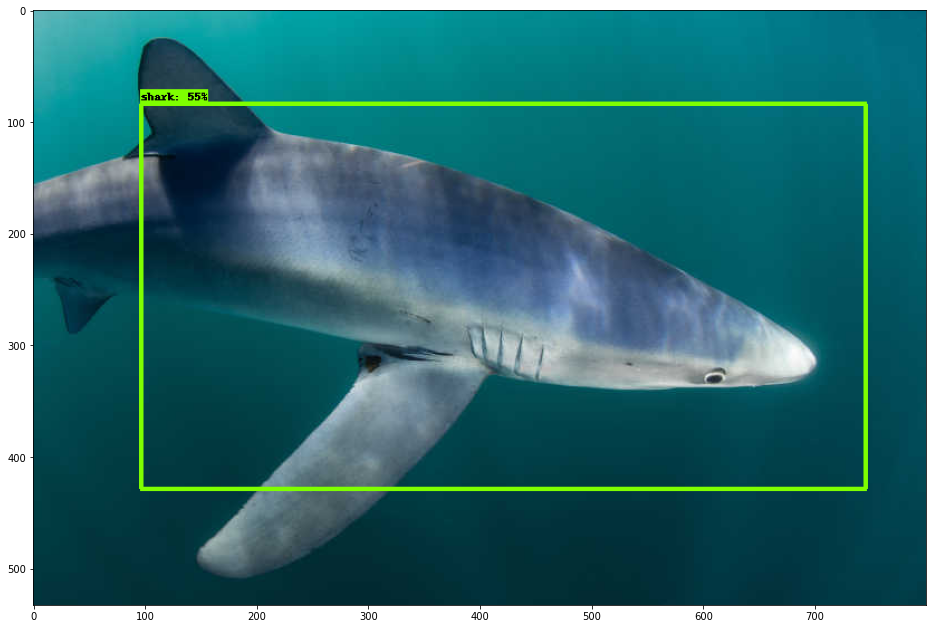

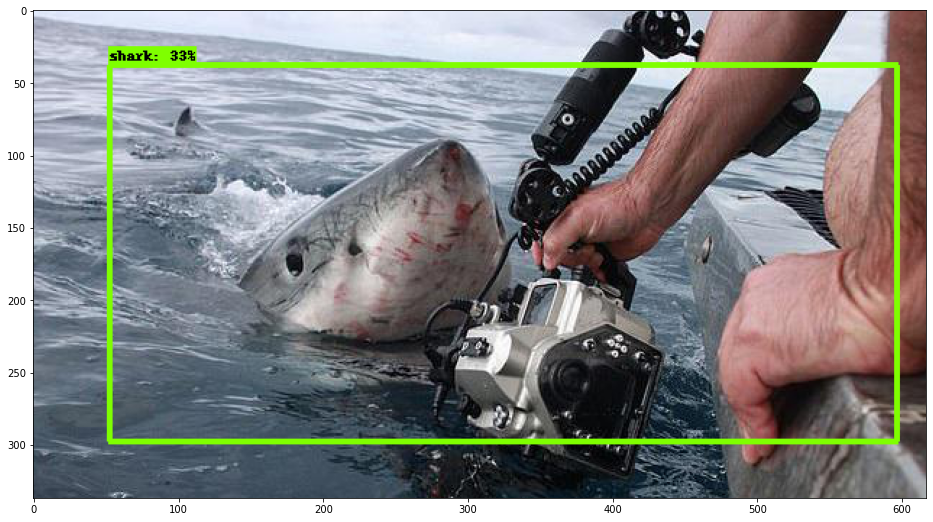

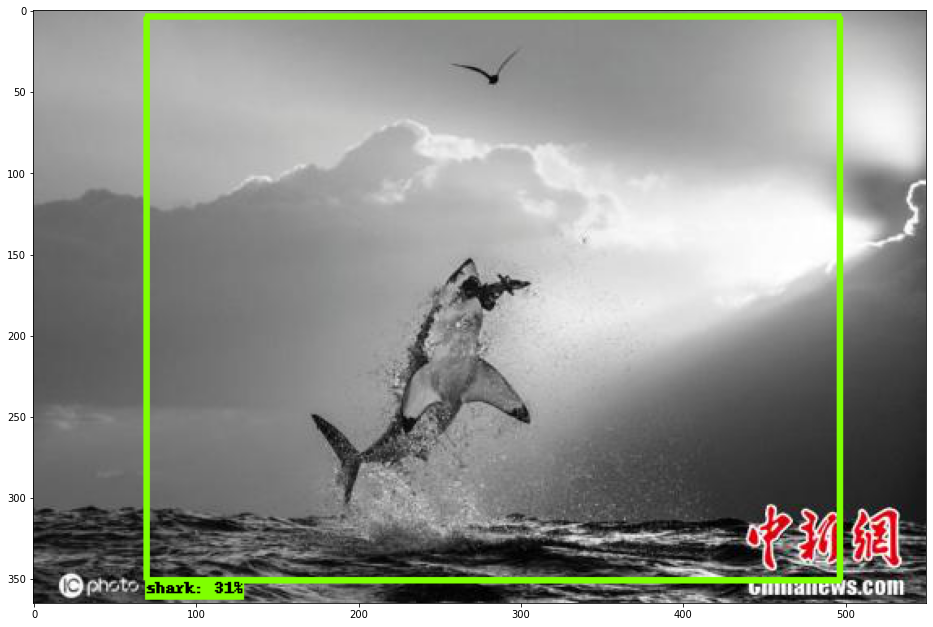

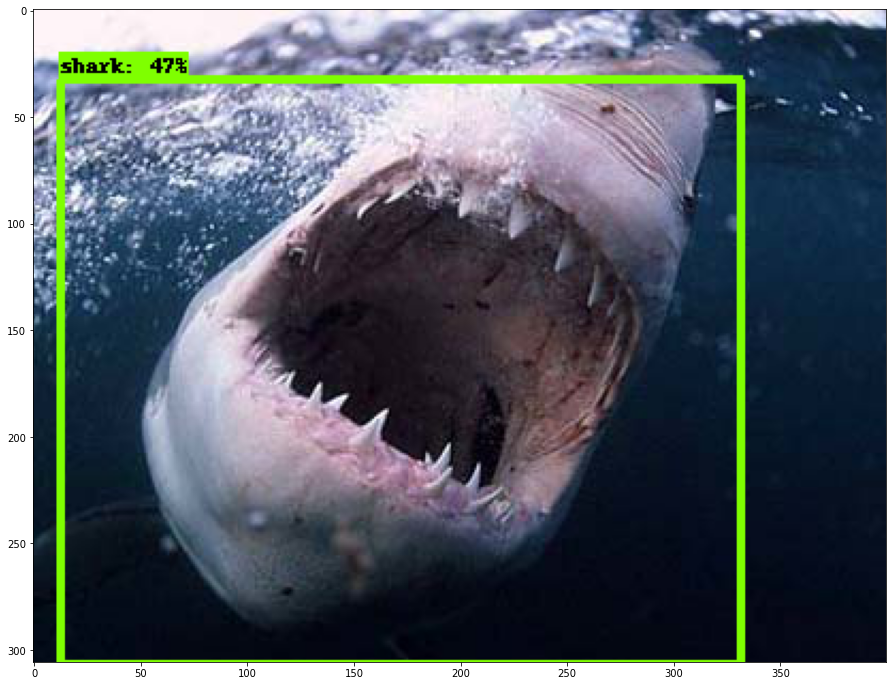

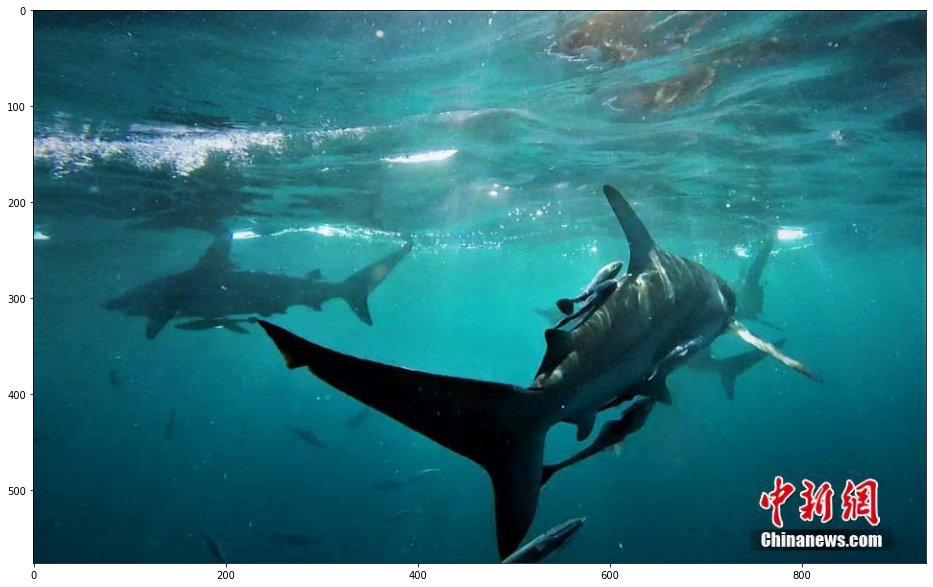

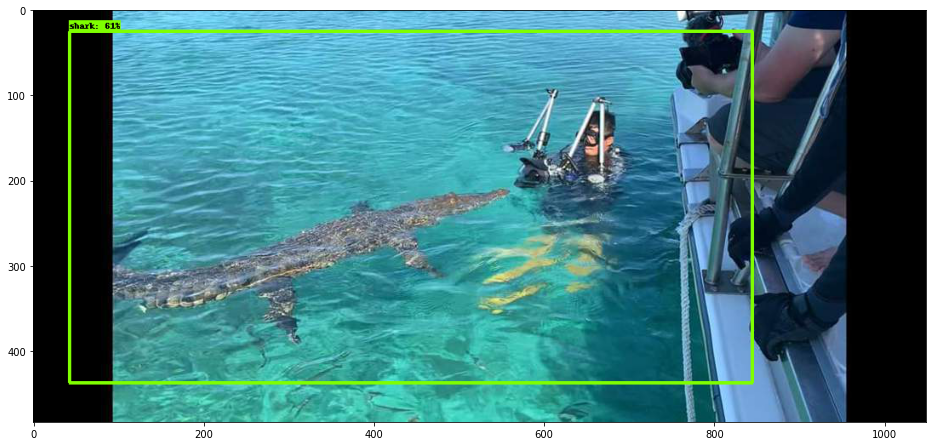

In [15]:
import numpy as np
from PIL import Image
from object_detection.utils import visualization_utils as viz_utils
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')   # Suppress Matplotlib warnings

def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.

    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.

    Args:
      path: the file path to the image

    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(Image.open(path))

def detectShark(image_path):
    image_np = load_image_into_numpy_array(image_path)
    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]
    # input_tensor = np.expand_dims(image_np, 0)
    detections = detect_fn(input_tensor)
    # All outputs are batches tensors.
    # Convert to numpy arrays, and take index [0] to remove the batch dimension.
    # We're only interested in the first num_detections.
    num_detections = int(detections.pop('num_detections'))
    detections = {key: value[0, :num_detections].numpy()
                   for key, value in detections.items()}
    detections['num_detections'] = num_detections

    # detection_classes should be ints.
    detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

    image_np_with_detections = image_np.copy()

    #"""
    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections,
          detections['detection_boxes'],
          detections['detection_classes'],
          detections['detection_scores'],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=200,
          min_score_thresh=.30)#,
          #agnostic_mode=False)
    #"""

    plt.figure(figsize=(16, 12))
    plt.imshow(image_np_with_detections)

IMAGE_PATHS = ['/content/detector_helper/images/test/shark_c_310.jpg',
               '/content/detector_helper/images/test/shark_c_116.jpg',
               '/content/detector_helper/images/test/shark_c_186.jpg',
               '/content/detector_helper/images/test/shark_c_202.jpg',
               '/content/detector_helper/images/test/shark_c_303.jpg',
               '/content/detector_helper/images/test/shark_c_485.jpg']

for image_path in IMAGE_PATHS:
  detectShark(image_path)


Clearly, the model is not always working properly and it even mistakes a crocodile with a shark!  
If we want we can also do predictions on images from internet.
For this we use a curl script.

In [16]:
%%bash
cd /content
curl https://www.scubadiving.com/sites/scubadiving.com/files/styles/500_1x_/public/images/2016/06/photo-contest-alex-suh-unmarked_bw_great_white_curved.jpg?itok=WB67-h_W > image.jpg

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 20701  100 20701    0     0  27936      0 --:--:-- --:--:-- --:--:-- 27936


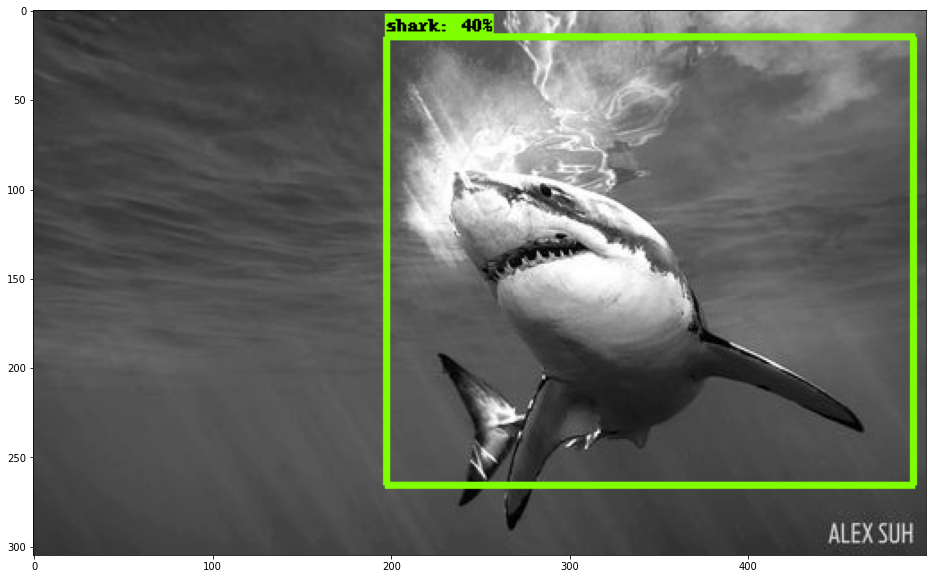

In [17]:
detectShark('/content/image.jpg')

This time it went better.  
# Conclusions
Altought the model has been trained properly and loss function value is below 1 the model still makes mistakes.  
To further boost accuracy bigger train data set should be obtained.
Moreover, there is a risk that the model can mistake other see creatures with sharks.
If high precision is required categories for other fish should be added.